In [11]:
import matplotlib.pyplot as plt
import numpy as np
from numpy import random
import copy
from matplotlib.animation import FuncAnimation
import matplotlib
import os
from mpl_toolkits.mplot3d import Axes3D
import copy
import math
import pandas as pd
class Atom:
    x = y = z = 0.0
    mass = 0.0 
    radius = 0.0
    energy = []
class Configuration:
    def __init__(self,na):
        self.natoms = na
        self.COM = [0.0,0.0,0.0]
        self.atom = []
        for i in range(na):
            self.atom.append(Atom())
    
    def CalcCOM(self):
        M = 0.0
        sumx = sumy = sumz = 0.0
        for i in range(0, self.natoms):
            m = self.atom[i].mass
            sumx += self.atom[i].x * m
            sumy += self.atom[i].y * m
            sumz += self.atom[i].z * m
            M += m

        Cx = sumx/M
        Cy = sumy/M
        Cz = sumz/M
        self.COM[0]=Cx
        self.COM[1]=Cy
        self.COM[2]=Cz
    
    def RadGyr(self):
        sumgyr = 0.0
        M = 0.0
        self.CalcCOM()
        comx = self.COM[0]
        comy = self.COM[1]
        comz = self.COM[2]
        for i in range(0, self.natoms):
            M += self.atom[i].mass
            mc = self.atom[i].mass
            rx = self.atom[i].x
            ry = self.atom[i].y
            rz = self.atom[i].z
            sgx = (rx - comx)**2.0
            sgy = (ry - comy)**2.0
            sgz = (rz - comz)**2.0

            sumgyr += mc*(sgx+sgy+sgz)

        Rsq = sumgyr / M
        R = math.sqrt(Rsq)
        return R
            
        
N = 40
L = 20
d = L/N
steps = 10
numexchg = 10
sigma=1.3*d  #Angstrom
epsilon=d #kJ/mol
#temp=[300.00, 353.49, 414.11, 482.85, 560.86, 600.00]
temp=[300.00, 353.49, 414.11, 682.85, 860.86, 10000.00]
kb=1.38e-23*6.022e23/(1000)  #kJ/mol*K
#kb=1.38e-23
cutoff=L/2 - 1
max_move=1
mass = 12.0 #mass of partical
center = [L/2,L/2,L/2] #center of box
def inbox(x,y,z):     
    if x > L-d/2:
        x -= L-d
    elif x < d/2:
        x += L - d

    if y > L-d/2:
        y -= L-d
    elif y < d/2:
        y += L - d
  
    if z > L-d/2:
        z -= L-d
    elif z < d/2:
        z += L - d   
    return x,y,z
def lj_potential(r):
    energy = 4*epsilon*(((sigma/r)**12)-((sigma/r)**6))
    return energy
def energy(r,x,y,z,n,compute_all=True):
    x_left = list(r[:,0]-L)
    x_right = list(r[:,0]+L)
    y_left = list(r[:,1]-L)
    y_right = list(r[:,1]+L)
    z_left = list(r[:,2]-L)
    z_right = list(r[:,2]+L)
    all_box = np.array([(x_left*3+list(r[:,0])*3+x_right*3)*3, \
                        ((y_left+list(r[:,1])+y_right)*3)*3, \
                        z_right*9+list(r[:,2])*9+z_left*9])
    all_box = all_box.transpose((1,0))
    #print(np.shape(all_box))
    i = 13*N
    distance = []
    if compute_all: 
        while i < 14*N:
            distance += [np.sqrt((all_box[i][0]-all_box[n][0])**2+ \
                                 (all_box[i][1]-all_box[n][1])**2+ \
                                 (all_box[i][2]-all_box[n][2])**2) for n in \
                         list(np.linspace(0,13*N-1,13*N,dtype=int))+ \
                         list(np.linspace(i+1,27*N-1,27*N-i-1,dtype=int))]
            i += 1
      #  print(distance)
        energy = [lj_potential(d) for d in distance if d < cutoff and d > 0]
        #print(energy)
        energy_sum = sum(energy)
    else:
        all_box[13*N+n] = [x,y,z]      #update coordinate      
        #print(all_box[13*N**2+n])       
        r0 = np.array([[x for d in range(27*N)],[y for d in range(27*N)],\
                       [z for d in range(27*N)]]) 
        a = r0.transpose((1,0)) - all_box  #compare the updated particle coordinate with others
        distance = [np.sqrt(a[i][0]**2+a[i][1]**2+a[i][2]**2) for i in range(27*N)]  #calculate distance    
        #print(sorted(distance))    
        energy = [lj_potential(d) for d in distance if d < cutoff and d > 0]
        #print(energy)
        energy_sum = sum(energy)
        #print(energy_sum)
    return energy_sum
def move(r,x,y,z,n,e,diff_e,temp):                         
    if diff_e < 0:
        e += diff_e
        r[n][0],r[n][1],r[n][2] = inbox(x_new,y_new,z_new)
    else:
        rand = random.random()
        if math.exp(-diff_e/(kb*temp)) > rand:
            e += diff_e
            r[n][0],r[n][1],r[n][2] = inbox(x_new,y_new,z_new)
    return r,e
def delta(temp1,temp2,energy1,energy2):
    ddelta = (1/(kb*temp1) - 1/(kb*temp2))*(energy2-energy1)
    return ddelta
def exchange(frame,energy,numexchg):
    if numexchg % 2 == 0:
        for i in [[0,1],[2,3],[4,5]]:
            dd = delta(temp[i[0]],temp[i[1]],energy[i[0]][(numexchg+1)*(steps+1)-1],energy[i[1]][(numexchg+1)*(steps+1)-1])
            if dd <= 0:
                frame[i[0]][(numexchg+1)*(steps+1)] = frame[i[1]][(numexchg+1)*(steps+1)-1]
                frame[i[1]][(numexchg+1)*(steps+1)] = frame[i[0]][(numexchg+1)*(steps+1)-1]
                energy[i[0]][(numexchg+1)*(steps+1)] = energy[i[1]][(numexchg+1)*(steps+1)-1]
                energy[i[1]][(numexchg+1)*(steps+1)] = energy[i[0]][(numexchg+1)*(steps+1)-1]
                temp_exchange[numexchg+1][i[0]] = temp_exchange[numexchg][i[1]]
                temp_exchange[numexchg+1][i[1]] = temp_exchange[numexchg][i[0]]
                accepted_exchange[numexchg][i[0]] = 1
                accepted_exchange[numexchg][i[1]] = 1

                accepted_exchange_ratio[numexchg][i[0]] = accepted_exchange[0:numexchg+1,i[0]].sum()/(numexchg+1)
                accepted_exchange_ratio[numexchg][i[1]] = accepted_exchange[0:numexchg+1,i[1]].sum()/(numexchg+1)
            else:
                rand = random.uniform(0,1)
                if math.exp(-dd) > rand:
                    frame[i[0]][(numexchg+1)*(steps+1)] = frame[i[1]][(numexchg+1)*(steps+1)-1]
                    frame[i[1]][(numexchg+1)*(steps+1)] = frame[i[0]][(numexchg+1)*(steps+1)-1]
                    energy[i[0]][(numexchg+1)*(steps+1)] = energy[i[1]][(numexchg+1)*(steps+1)-1]
                    energy[i[1]][(numexchg+1)*(steps+1)] = energy[i[0]][(numexchg+1)*(steps+1)-1]
                    temp_exchange[numexchg+1][i[0]] = temp_exchange[numexchg][i[1]]
                    temp_exchange[numexchg+1][i[1]] = temp_exchange[numexchg][i[0]]
                    accepted_exchange[numexchg][i[0]] = 1
                    accepted_exchange[numexchg][i[1]] = 1
                    accepted_exchange_ratio[numexchg][i[0]] = accepted_exchange[0:numexchg+1,i[0]].sum()/(numexchg+1)
                    accepted_exchange_ratio[numexchg][i[1]] = accepted_exchange[0:numexchg+1,i[1]].sum()/(numexchg+1)
                else:
                    frame[i[0]][(numexchg+1)*(steps+1)] = frame[i[0]][(numexchg+1)*(steps+1)-1]
                    frame[i[1]][(numexchg+1)*(steps+1)] = frame[i[1]][(numexchg+1)*(steps+1)-1]
                    energy[i[0]][(numexchg+1)*(steps+1)] = energy[i[0]][(numexchg+1)*(steps+1)-1]
                    energy[i[1]][(numexchg+1)*(steps+1)] = energy[i[1]][(numexchg+1)*(steps+1)-1]
                    temp_exchange[numexchg+1][i[0]] = temp_exchange[numexchg][i[0]]
                    temp_exchange[numexchg+1][i[1]] = temp_exchange[numexchg][i[1]]
                    accepted_exchange[numexchg][i[0]] = 0
                    accepted_exchange[numexchg][i[1]] = 0
                    accepted_exchange_ratio[numexchg][i[0]] = accepted_exchange[0:numexchg+1,i[0]].sum()/(numexchg+1)
                    accepted_exchange_ratio[numexchg][i[1]] = accepted_exchange[0:numexchg+1,i[1]].sum()/(numexchg+1)
                
    else:
        for i in [[0,5],[1,2],[3,4]]:
            dd = delta(temp[i[0]],temp[i[1]],energy[i[0]][(numexchg+1)*(steps+1)-1],energy[i[1]][(numexchg+1)*(steps+1)-1])
            if dd <= 0:
                frame[i[0]][(numexchg+1)*(steps+1)] = frame[i[1]][(numexchg+1)*(steps+1)-1]
                frame[i[1]][(numexchg+1)*(steps+1)] = frame[i[0]][(numexchg+1)*(steps+1)-1]
                energy[i[0]][(numexchg+1)*(steps+1)] = energy[i[1]][(numexchg+1)*(steps+1)-1]
                energy[i[1]][(numexchg+1)*(steps+1)] = energy[i[0]][(numexchg+1)*(steps+1)-1]
                temp_exchange[numexchg+1][i[0]] = temp_exchange[numexchg][i[1]]
                temp_exchange[numexchg+1][i[1]] = temp_exchange[numexchg][i[0]]
                accepted_exchange[numexchg][i[0]] = 1
                accepted_exchange[numexchg][i[1]] = 1
                
                accepted_exchange_ratio[numexchg][i[0]] = accepted_exchange[0:numexchg+1,i[0]].sum()/(numexchg+1)
                accepted_exchange_ratio[numexchg][i[1]] = accepted_exchange[0:numexchg+1,i[1]].sum()/(numexchg+1)
            else:
                rand = random.uniform(0,1)
                if math.exp(-dd) > rand:
                    frame[i[0]][(numexchg+1)*(steps+1)] = frame[i[1]][(numexchg+1)*(steps+1)-1]
                    frame[i[1]][(numexchg+1)*(steps+1)] = frame[i[0]][(numexchg+1)*(steps+1)-1]
                    energy[i[0]][(numexchg+1)*(steps+1)] = energy[i[1]][(numexchg+1)*(steps+1)-1]
                    energy[i[1]][(numexchg+1)*(steps+1)] = energy[i[0]][(numexchg+1)*(steps+1)-1]
                    temp_exchange[numexchg+1][i[0]] = temp_exchange[numexchg][i[1]]
                    temp_exchange[numexchg+1][i[1]] = temp_exchange[numexchg][i[0]]
                    accepted_exchange[numexchg][i[0]] = 1
                    accepted_exchange[numexchg][i[1]] = 1
                    accepted_exchange_ratio[numexchg][i[0]] = accepted_exchange[0:numexchg+1,i[0]].sum()/(numexchg+1)
                    accepted_exchange_ratio[numexchg][i[1]] = accepted_exchange[0:numexchg+1,i[1]].sum()/(numexchg+1)
                else:
                    frame[i[0]][(numexchg+1)*(steps+1)] = frame[i[0]][(numexchg+1)*(steps+1)-1]
                    frame[i[1]][(numexchg+1)*(steps+1)] = frame[i[1]][(numexchg+1)*(steps+1)-1]
                    energy[i[0]][(numexchg+1)*(steps+1)] = energy[i[0]][(numexchg+1)*(steps+1)-1]
                    energy[i[1]][(numexchg+1)*(steps+1)] = energy[i[1]][(numexchg+1)*(steps+1)-1]
                    temp_exchange[numexchg+1][i[0]] = temp_exchange[numexchg][i[0]]
                    temp_exchange[numexchg+1][i[1]] = temp_exchange[numexchg][i[1]]
                    accepted_exchange[numexchg][i[0]] = 0
                    accepted_exchange[numexchg][i[1]] = 0
                    accepted_exchange_ratio[numexchg][i[0]] = accepted_exchange[numexchg+1,i[0]].sum()/(numexchg+1)
                    accepted_exchange_ratio[numexchg][i[1]] = accepted_exchange[numexchg+1,i[1]].sum()/(numexchg+1)

c = Configuration(N) 
#x_init = sorted([i*d for i in range(1,N+1)]*N)
#y_init = [i*d for i in range(1,N+1)]*N
#z_init = [d/2 for i in range(N)]*N
for index in range(N):
    c.atom[index].x = center[0]+ (L-d) * (random.random()-0.5)
    c.atom[index].y = center[1]+ (L-d) * (random.random()-0.5)
    c.atom[index].z = center[2]+ (L-d) * (random.random()-0.5)
    c.atom[index].mass = mass
    c.atom[index].radius = d/2
point = np.array([[c.atom[i].x for i in range(N)],[c.atom[i].y for i in range(N)],
                  [c.atom[i].z for i in range(N)]])
point = point.transpose((1,0))
e = energy(point,0,0,0,0,compute_all=True)
print(e)
all_energy = np.zeros((len(temp),(numexchg)*(steps+1)+1))
all_energy[:,0] = e
#print(all_energy[0])
all_frame = np.zeros((len(temp),(numexchg)*(steps+1)+1,N,3))
all_frame[:,0] = point
accepted_exchange = np.zeros((numexchg,len(temp)))
accepted_exchange_ratio = np.zeros((numexchg,len(temp)))
temp_exchange = np.zeros((numexchg+1,len(temp)))
temp_exchange[0] = temp
for n in range(numexchg):
    
    for t in range(len(temp)):
        #final_frame=np.zeros((len(temp),N*N,3))
        x_init = all_frame[t][n*(steps+1)][:,0]
        y_init = all_frame[t][n*(steps+1)][:,1]
        z_init = all_frame[t][n*(steps+1)][:,2]
        e = all_energy[t][n*(steps+1)]
        #print(e)
        point = np.array([x_init,y_init,z_init])
        point = point.transpose((1,0))
        for i in range(steps):
            #pre_e = e
            #origi = copy.deepcopy(point)
            for m in range(N): 
                x,y,z = point[m][0],point[m][1],point[m][2]
                e_old = energy(point,x,y,z,m,compute_all=False)
                #print(e_old)
                x_new = x+max_move*random.uniform(-1,1)
                y_new = y+max_move*random.uniform(-1,1)
                z_new = z+max_move*random.uniform(-1,1)
              # x_new,y_new,z_new = inbox(x_new,y_new,z_new)
                e_new = energy(point,x_new,y_new,z_new,m,compute_all=False)
                diff_e = e_new - e_old
                #print(diff_e)
                point, e = move(point,x_new,y_new,z_new,m,e,diff_e,temp[t])
            

            all_energy[t][i+1+(steps+1)*n] = e
            all_frame[t][i+1+(steps+1)*n] = point      
      #  final_frame[t] = all_frame[t][-1]
    exchange(all_frame,all_energy,n)


data={}
for i in range(len(temp)):
    data['temp{}'.format(i)] = all_energy[i]
all_energy = pd.DataFrame(data=data,index=range((numexchg)*(steps+1)+1))
print(temp_exchange)   
print(accepted_exchange)
print(accepted_exchange_ratio)
print(all_energy) 

-0.36958479501082
-0.36958479501082
-0.36958479501082


KeyboardInterrupt: 

(0.0, 30.0)

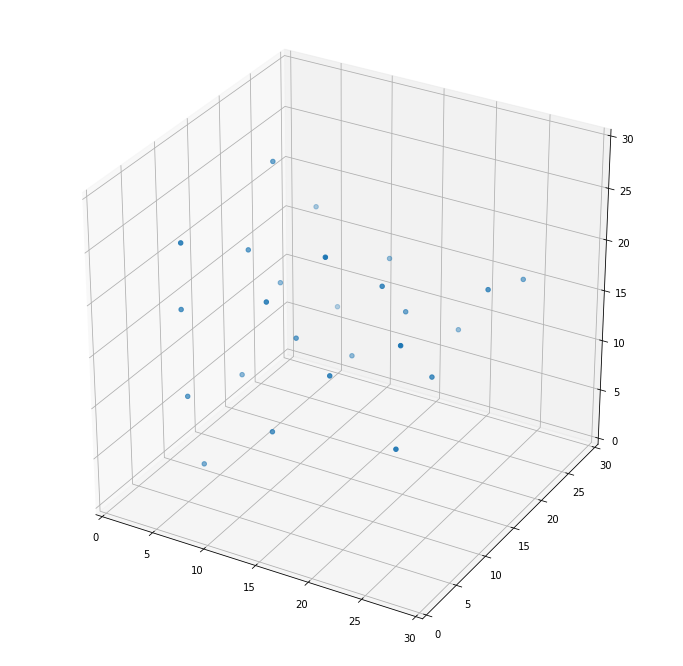

In [0]:
fig = plt.figure()
fig.set_figheight(12)
fig.set_figwidth(12)
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(point[:,0],point[:,1],point[:,2])
ax.scatter(all_frame[0][-2][:,0],all_frame[0][-2][:,1],all_frame[0][-2][:,2],)
ax.set_xlim(0,L)
ax.set_ylim(0,L)
ax.set_zlim(0,L)

[-16.762705230569292, -540.9334493417226, -578.4437683809582, -583.3884088458476, -591.4766175216844, -594.407598638652, -593.6070806930118, -594.0363282470935, -595.2987055676222, -595.3719146593537]


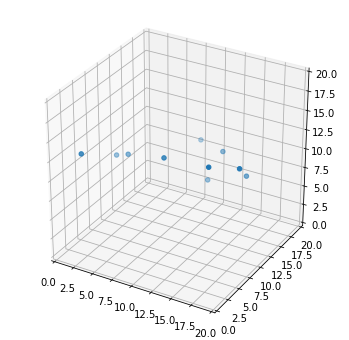

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from numpy import random
import copy
from matplotlib.animation import FuncAnimation
import matplotlib
import os
from mpl_toolkits.mplot3d import Axes3D
import copy
import math

class Atom:
    x = y = z = 0.0
    mass = 0.0 
    radius = 0.0
class Configuration:
    def __init__(self,na):
        self.natoms = na
        self.COM = [0.0,0.0,0.0]
        self.atom = []
        for i in range(na):
            self.atom.append(Atom())
    
    def CalcCOM(self):
        M = 0.0
        sumx = sumy = sumz = 0.0
        for i in range(0, self.natoms):
            m = self.atom[i].mass
            sumx += self.atom[i].x * m
            sumy += self.atom[i].y * m
            sumz += self.atom[i].z * m
            M += m

        Cx = sumx/M
        Cy = sumy/M
        Cz = sumz/M
        self.COM[0]=Cx
        self.COM[1]=Cy
        self.COM[2]=Cz
    
    def RadGyr(self):
        sumgyr = 0.0
        M = 0.0
        self.CalcCOM()
        comx = self.COM[0]
        comy = self.COM[1]
        comz = self.COM[2]
        for i in range(0, self.natoms):
            M += self.atom[i].mass
            mc = self.atom[i].mass
            rx = self.atom[i].x
            ry = self.atom[i].y
            rz = self.atom[i].z
            sgx = (rx - comx)**2.0
            sgy = (ry - comy)**2.0
            sgz = (rz - comz)**2.0

            sumgyr += mc*(sgx+sgy+sgz)

        Rsq = sumgyr / M
        R = math.sqrt(Rsq)
        return R
N = 10  #number of partical
L = 20  #length of box
d = L/N  #diameter of hard ball
steps = 1000  #total steps
sigma=2*d   #sigma in lj potential
epsilon=2*d  #epsilon in lj potential
temp=300 #temperature 
kb=1.38e-23*6.022e23/(1000*4.184)  #bolzmann constant
cutoff=L/2-1  #cutoff of pair-wise interaction
x_delta=1  #maximum move of x
y_delta=1  #maximum move of y
z_delta=1  #maximum move of z
mass = 12.0 #mass of partical
center = [L/2,L/2,L/2] #center of box
#check if inbox
def inbox(x,y,z):     
    if x > L-d/2:
        x -= L-d
    elif x < d/2:
        x += L - d

    if y > L-d/2:
        y -= L-d
    elif y < d/2:
        y += L - d
  
    if z > L-d/2:
        z -= L-d
    elif z < d/2:
        z += L - d   
    return x,y,z
#lj potential
def lj_potential(r):
    energy = 4*epsilon*(((sigma/r)**12)-((sigma/r)**6))
    return energy
#pair-wise interaction calculation
def energy(r,x,y,z,n,compute_all=True):
    x_left = list(r[:,0]-L)
    x_right = list(r[:,0]+L)
    y_left = list(r[:,1]-L)
    y_right = list(r[:,1]+L)
    z_left = list(r[:,2]-L)
    z_right = list(r[:,2]+L)
    all_box = np.array([(x_left*3+list(r[:,0])*3+x_right*3)*3, \
                        ((y_left+list(r[:,1])+y_right)*3)*3, \
                        z_right*9+list(r[:,2])*9+z_left*9])
    all_box = all_box.transpose((1,0))
    #print(np.shape(all_box))
    i = 13*N
    distance = []
    if compute_all: 
        while i < 14*N:
            distance += [np.sqrt((all_box[i][0]-all_box[n][0])**2+ \
                                 (all_box[i][1]-all_box[n][1])**2+ \
                                 (all_box[i][2]-all_box[n][2])**2) for n in \
                         list(np.linspace(0,13*N-1,13*N,dtype=int))+ \
                         list(np.linspace(i+1,27*N-1,27*N-i-1,dtype=int))]
            i += 1
      #  print(distance)
        energy = [lj_potential(d) for d in distance if d < cutoff and d > 0]
        #print(energy)
        energy_sum = sum(energy)
    else:
        all_box[13*N+n] = [x,y,z]      #update coordinate      
        #print(all_box[13*N**2+n])       
        r0 = np.array([[x for d in range(27*N)],[y for d in range(27*N)],\
                       [z for d in range(27*N)]]) 
        a = r0.transpose((1,0)) - all_box  #compare the updated particle coordinate with others
        distance = [np.sqrt(a[i][0]**2+a[i][1]**2+a[i][2]**2) for i in range(27*N)]  #calculate distance    
        #print(sorted(distance))    
        energy = [lj_potential(d) for d in distance if d < cutoff and d > 0]
        #print(energy)
        energy_sum = sum(energy)
        #print(energy_sum)
    return energy_sum
#metropolis move criterion
def move(r, x,y,z,n,e, diff_e, temp):                         
    '''x,y are new move coordinate; n represents all coordinate, 
       i is which particle, N is how many particles in total. this
       function will compute the total distance after moving one particle '''
   # n[i] = [x,y,z]      #update coordinate             
   # n0 = np.array([[x for d in range(N)],[y for d in range(N)],[z for d in range(N)]]) 
   # a = n0.transpose((1,0)) - n  #compare the updated particle coordinate with others
   # distance = [np.sqrt(a[i][0]**2+a[i][1]**2+a[i][2]**2) for i in range(N)]  #calculate distance

    if diff_e < 0:
        e += diff_e
        #pre_e += diff_e
        r[n][0],r[n][1],r[n][2] = inbox(x_new,y_new,z_new)
    else:
        rand = random.random()
        if math.exp(-diff_e/(kb*temp)) > rand:
            e += diff_e
           # pre_e += e
            r[n][0],r[n][1],r[n][2] = inbox(x_new,y_new,z_new)
       # else:
            #r = origi
            #e = pre_e
    return r,e
#initialize system
c = Configuration(N) 
#x_init = sorted([i*d for i in range(1,N+1)]*N)
#y_init = [i*d for i in range(1,N+1)]*N
#z_init = [d/2 for i in range(N)]*N
for index in range(N):
    c.atom[index].x = center[0]+ (L-d) * (random.random()-0.5)
    c.atom[index].y = center[1]+ (L-d) * (random.random()-0.5)
    c.atom[index].z = center[2]+ (L-d) * (random.random()-0.5)
    c.atom[index].mass = mass
    c.atom[index].radius = d/2
point = np.array([[c.atom[i].x for i in range(N)],[c.atom[i].y for i in range(N)],
                  [c.atom[i].z for i in range(N)]])
point = point.transpose((1,0))
e = energy(point,0,0,0,0,compute_all=True)
#print(e)
all_energy = [e]
fig = plt.figure()
fig.set_figheight(6)
fig.set_figwidth(6)
ax = fig.add_subplot(111, projection='3d')
ax.scatter(point[:,0],point[:,1],point[:,2])
ax.set_xlim(0,L)
ax.set_ylim(0,L)
ax.set_zlim(0,L)
all_frame = np.zeros((steps+1,N,3))
all_frame[0] = point

for i in range(steps):
    #pre_e = e
  #  origi = copy.deepcopy(point)
    for m in range(N): 
        x,y,z = point[m][0],point[m][1],point[m][2]
        e_old = energy(point,x,y,z,m,compute_all=False)
        #print(e_old)
        x_new = x+x_delta*random.uniform(-1,1)
        y_new = y+y_delta*random.uniform(-1,1)
        z_new = z+z_delta*random.uniform(-1,1)
       # x_new,y_new,z_new = inbox(x_new,y_new,z_new)
        e_new = energy(point,x_new,y_new,z_new,m,compute_all=False)
        diff_e = e_new - e_old
        #print(diff_e)
        point, e = move(point,x_new,y_new,z_new,m,e,diff_e,temp)
    all_energy.append(e)
    all_frame[i+1] = point
#    x_init = point[:,0]
#    y_init = point[:,1]
#    z_init = point[:,2]       
print(all_energy[0:-1:100])

In [13]:
##fig = plt.figure()
#fig.set_figheight(12)
#fig.set_figwidth(12)
#ax = fig.add_subplot(111, projection='3d')
#ax.scatter(point[:,0],point[:,1],point[:,2])
#ax.scatter(all_frame[-1][:,0],all_frame[-1][:,1],all_frame[-1][:,2],)
#ax.set_xlim(0,L)
#ax.set_ylim(0,L)
#ax.set_zlim(0,L)
#rint(len(point[:,0]))

In [15]:
import sys
a =sys.executable
print(a)
import plotly.graph_objects as go
#help(go.Figure)

fig = go.Figure()

for i in np.arange(0,steps,10):
    fig.add_trace(
        go.Scatter3d(
            visible=False,
            mode='markers',
            marker=dict(size=3),
            x = all_frame[i][:,0], 
            y = all_frame[i][:,1],
            z = all_frame[i][:,2]
        )
    )
steps1 = []
for i in range(len(fig.data)):
    step = dict(method='restyle',args=['visible', [False]*len(fig.data)])
    step['args'][1][i] = True
    steps1.append(step)
sliders = [dict(
    active=60,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 60},
    steps=steps1
)]
fig.update_layout(
    sliders=sliders,
    scene = dict(
    xaxis = dict(nticks=4, range=[0,L],),
    yaxis = dict(nticks=4, range=[0,L],),
    zaxis = dict(nticks=4, range=[0,L],)))

fig.show()

/Users/liweichang/Program/anaconda3/envs/ml/bin/python


/Users/liweichang/Program/anaconda3/envs/ml/lib/python3.6/site-packages/ipykernel_launcher.py:44: RuntimeWarning:

divide by zero encountered in double_scalars

/Users/liweichang/Program/anaconda3/envs/ml/lib/python3.6/site-packages/ipykernel_launcher.py:44: RuntimeWarning:

invalid value encountered in double_scalars

/Users/liweichang/Program/anaconda3/envs/ml/lib/python3.6/site-packages/ipykernel_launcher.py:130: RuntimeWarning:

overflow encountered in exp



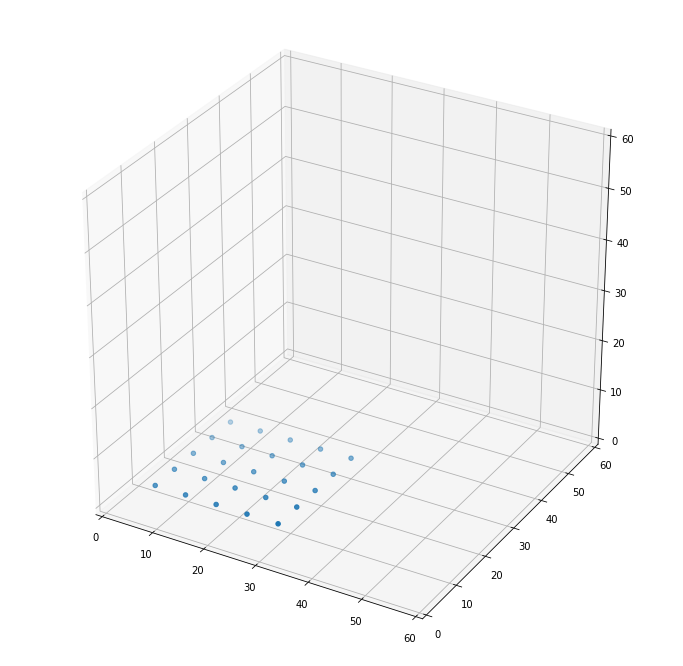

In [12]:
import matplotlib.pyplot as plt
import numpy as np
from numpy import random
import copy
from matplotlib.animation import FuncAnimation
import matplotlib
import os
from mpl_toolkits.mplot3d import Axes3D
import copy
import math


N = 5
L = 30
d = L/N
cutoff=L/2-0.5
steps = 1000
sigma=2*d
epsilon=2*d
temp=300
kb=1.38e-23*6.022e23/(1000*4.184)
x_delta=0.5
y_delta=0.5
z_delta=2
press=1.0
maxdv=0.02
def inbox(x,y,z):     
    if x > L-d/2:
        x -= L-d
    elif x < d/2:
        x += L - d

    if y > L-d/2:
        y -= L-d
    elif y < d/2:
        y += L - d
  
    if z > L-d/2:
        z -= L-d
    elif z < d/2:
        z += L - d   
    return x,y,z
def lj_potential(r):
    energy = 4*epsilon*(((sigma/r)**12)-((sigma/r)**6))
    return energy
def energy(r,x,y,z,n,compute_all=True):
    N = len(r[:,0])
    i = 0
    distance = []
    if compute_all: 
        while i < N*N:
            distance += [np.sqrt((r[i][0]-r[n][0])**2+(r[i][1]-r[n][1])**2  \
                                 +(r[i][2]-r[n][2])**2) for n in range(i+1,N)]
            i += 1
        energy = [lj_potential(d) for d in distance]
        energy_sum = sum(energy)
    else:
        r[n] = [x,y,z]      #update coordinate             
        r0 = np.array([[x for d in range(N)],[y for d in range(N)],[z for d in range(N)]]) 
        a = r0.transpose((1,0)) - r  #compare the updated particle coordinate with others
        distance = [np.sqrt(a[i][0]**2+a[i][1]**2+a[i][2]**2) for i in range(N)]  #calculate distance        
        energy = [lj_potential(d) for d in distance]
        energy_sum = sum(energy)
    return energy_sum
def move(r, e, diff_e, temp):                         
    '''x,y are new move coordinate; n represents all coordinate, 
       i is which particle, N is how many particles in total. this
       function will compute the total distance after moving one particle '''
   # n[i] = [x,y,z]      #update coordinate             
   # n0 = np.array([[x for d in range(N)],[y for d in range(N)],[z for d in range(N)]]) 
   # a = n0.transpose((1,0)) - n  #compare the updated particle coordinate with others
   # distance = [np.sqrt(a[i][0]**2+a[i][1]**2+a[i][2]**2) for i in range(N)]  #calculate distance

    if diff_e < 0:
        e += diff_e
    else:
        rand = random.random()
        if math.exp(-diff_e/(kb*temp)) > rand:
            e += diff_e
        else:
            r = origi
            e = pre_e
    return r,e

x_init = sorted([i*d for i in range(1,N+1)]*N)
y_init = [i*d for i in range(1,N+1)]*N
z_init = [d/2 for i in range(N)]*N
point = np.array([x_init,y_init,z_init])
point = point.transpose((1,0))
e = energy(point,0,0,0,0,compute_all=True)
all_energy = [e]
fig = plt.figure()
fig.set_figheight(12)
fig.set_figwidth(12)
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_init,y_init,z_init)
ax.set_xlim(0,60)
ax.set_ylim(0,60)
ax.set_zlim(0,60)
all_frame = np.zeros((steps+1,N*N,3))
all_frame[0] = point
all_L = [L**3]
for i in range(steps):
    pre_e = e
    origi = copy.deepcopy(point)
    rand = random.random()
    if (rand*N*N+1)+1 < N*N:        
        for m in range(N*N): 
            x,y,z = inbox(x_init[m],y_init[m],z_init[m])
            e_old = energy(point,x,y,z,m,compute_all=False)
            x_new = x+x_delta*random.uniform(-1,1)
            y_new = y+y_delta*random.uniform(-1,1)
            z_new = z+z_delta*random.uniform(-1,1)
            x_new,y_new,z_new = inbox(x_new,y_new,z_new)
            e_new = energy(point,x_new,y_new,z_new,m,compute_all=False)
            diff_e = e_new - e_old
            point, e = move(point,e,diff_e,temp)
    else:
        x,y,z = inbox(x_init[m],y_init[m],z_init[m])
        e_old = energy(point,0,0,0,0,compute_all=True)
        pre_v = L**3
        lnvTrial = np.log(pre_v) + random.uniform(-1,1)*maxdv
        vTrial = np.exp(lnvTrial)
        new_L = vTrial**(1.0/3)
        pointTrial = point*(new_L/L)
        new_e = energy(pointTrial,0,0,0,0,compute_all=True)
        weight = (new_e - e_old) + press*(vTrial - pre_v) - (N*N+1)*temp*np.log(vTrial/pre_v)
        rand = random.random()
        
        if np.exp(-weight/temp*kb) > rand:
            e = new_e
            point = pointTrial
            L = new_L

            

    all_energy.append(e)
    all_frame[i+1] = point
    x_init = point[:,0]
    y_init = point[:,1]
    z_init = point[:,2]   
    all_L.append(L**3)    


25


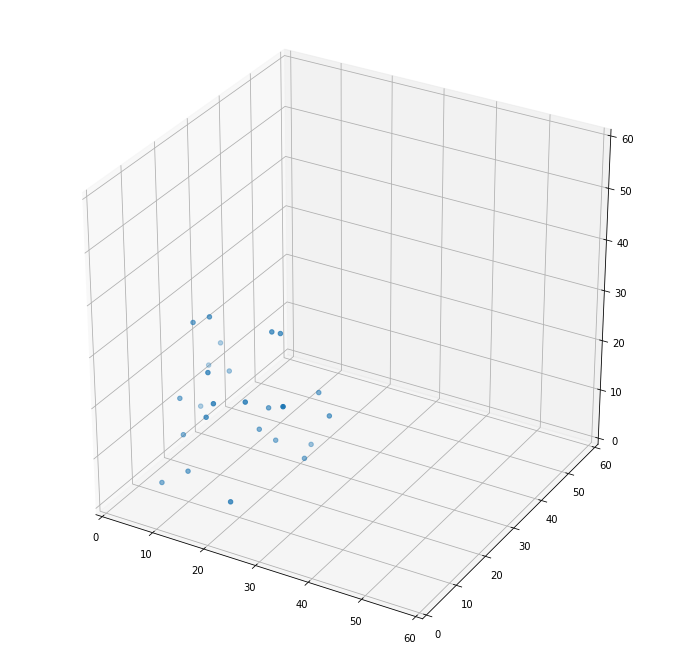

In [13]:
fig = plt.figure()
fig.set_figheight(12)
fig.set_figwidth(12)
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(point[:,0],point[:,1],point[:,2])
ax.scatter(all_frame[-1][:,0],all_frame[-1][:,1],all_frame[-1][:,2],)
ax.set_xlim(0,60)
ax.set_ylim(0,60)
ax.set_zlim(0,60)
print(len(point[:,0]))

In [15]:
import plotly.graph_objects as go
#help(go.Figure)

fig = go.Figure()

for i in range(steps):
    fig.add_trace(
        go.Scatter3d(
            visible=False,
            mode='markers',
            marker=dict(size=3),
            x = all_frame[i][:,0], 
            y = all_frame[i][:,1],
            z = all_frame[i][:,2]
        )
    )
steps1 = []
for i in range(len(fig.data)):
    step = dict(method='restyle',args=['visible', [False]*len(fig.data)])
    step['args'][1][i] = True
    steps1.append(step)
sliders = [dict(
    active=60,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 60},
    steps=steps1
)]
fig.update_layout(
    sliders=sliders,
    scene = dict(
    xaxis = dict(nticks=4, range=[0,70],),
    yaxis = dict(nticks=4, range=[0,70],),
    zaxis = dict(nticks=4, range=[0,70],)))


fig.show()

In [36]:
import sys
a=sys.executable
print(a)
import plotly
import plotly.graph_objects as go
import pandas as pd
import numpy as np
import plotly.express as px
traj=pd.read_csv('dash/std_all_frame_40.csv')
#print(traj)
x=np.array([traj.iloc[:,i][800] for i in range(0,60,6)])/2
y=np.array([traj.iloc[:,i][800] for i in range(1,60,6)])/2
z=np.array([traj.iloc[:,i][800] for i in range(2,60,6)])/2
x_left = list(x-15)
x_right = list(x+15)
y_left = list(y-15)
y_right = list(y+15)
z_left = list(z-15)
z_right = list(z+15)
all_x = (x_left*3+list(x)*3+x_right*3)*3
all_y = ((y_left+list(y)+y_right)*3)*3
all_z = z_right*9+list(z)*9+z_left*9
#all_box = np.array([(x_left*3+list(x)*3+x_right*3)*3,
#                    ((y_left+list(y)+y_right)*3)*3,
#                      z_right*9+list(z)*9+z_left*9)
#all_box = all_box.transpose((1,0))
fig = go.Figure(data=go.Scatter3d(x=all_x,y=all_y,z=all_z,mode='markers',marker=dict(size=2)))
fig.add_trace(go.Scatter3d(x=all_x[130:140],y=all_y[130:140],z=all_z[130:140],mode='markers',marker=dict(size=4,color='firebrick')))
fig.add_trace(go.Scatter3d(x=[0,15,None,15,15,None,15,0,None,0,0,None,0,0,None,15,15,None,15,15,None,0,0,None,0,15,None,15,15,None,15,0,None,0,0],
                                y=[0,0,None,0,15,None,15,15,None,15,0,None,0,0,None,0,0,None,15,15,None,15,15,None,0,0,None,0,15,None,15,15,None,15,0],
                                z=[0,0,None,0,0,None,0,0,None,0,0,None,0,15,None,0,15,None,0,15,None,0,15,None,15,15,None,15,15,None,15,15,None,15,15],mode='lines'
                                ,line=dict(color='firebrick',width=5)))
fig.add_trace(go.Scatter3d(x=[],y=[],z=[]))
fig.add_trace(go.Scatter3d(x=[-15,30,None,30,30,None,30,-15,None,-15,-15,None,-15,-15,None,30,30,None,30,30,None,-15,-15,None,-15,30,None,30,30,None,30,-15,None,-15,-15],
                           y=[-15,-15,None,-15,30,None,30,30,None,30,-15,None,-15,-15,None,-15,-15,None,30,30,None,30,30,None,-15,-15,None,-15,30,None,30,30,None,30,-15],
                           z=[-15,-15,None,-15,-15,None,-15,-15,None,-15,-15,None,-15,30,None,-15,30,None,-15,30,None,-15,30,None,30,30,None,30,30,None,30,30,None,30,30],mode='lines',line
                                   =dict(color='blue')))
fig.add_trace(go.Scatter3d(x=[-15,30,None,30,30,None,30,-15,None,-15,-15],
                           y=[-15,-15,None,-15,30,None,30,30,None,30,-15],
                           z=[0,0,None,0,0,None,0,0,None,0,0],mode='lines',line
                                   =dict(color='blue')))
fig.add_trace(go.Scatter3d(x=[-15,30,None,30,30,None,30,-15,None,-15,-15],
                           y=[-15,-15,None,-15,30,None,30,30,None,30,-15],
                           z=[15,15,None,15,15,None,15,15,None,15,15],mode='lines',line
                                   =dict(color='blue')))
fig.add_trace(go.Scatter3d(x=[30,-15,None,-15,-15,None,-15,30,None,30,30],
                           y=[15,15,None,15,15,None,15,15,None,15,15],
                           z=[-15,-15,None,-15,30,None,30,30,None,30,-15],mode='lines',line
                                   =dict(color='blue')))
fig.add_trace(go.Scatter3d(x=[30,-15,None,-15,-15,None,-15,30,None,30,30],
                           y=[0,0,None,0,0,None,0,0,None,0,0],
                           z=[-15,-15,None,-15,30,None,30,30,None,30,-15],mode='lines',line
                                   =dict(color='blue')))
fig.add_trace(go.Scatter3d(y=[30,-15,None,-15,-15,None,-15,30,None,30,30],
                           x=[15,15,None,15,15,None,15,15,None,15,15],
                           z=[-15,-15,None,-15,30,None,30,30,None,30,-15],mode='lines',line
                                   =dict(color='blue')))
fig.add_trace(go.Scatter3d(y=[30,-15,None,-15,-15,None,-15,30,None,30,30],
                           x=[0,0,None,0,0,None,0,0,None,0,0],
                           z=[-15,-15,None,-15,30,None,30,30,None,30,-15],mode='lines',line
                                   =dict(color='blue')))
fig.add_trace(go.Scatter3d(x=[-15,30,None,-15,30,None,-15,30,None,-15,30],
                                y=[0,0,None,15,15,None,15,15,None,0,0],
                                z=[0,0,None,0,0,None,15,15,None,15,15],mode='lines'
                                ,line=dict(color='blue')))
fig.add_trace(go.Scatter3d(y=[-15,30,None,-15,30,None,-15,30,None,-15,30],
                                x=[0,0,None,15,15,None,15,15,None,0,0],
                                z=[0,0,None,0,0,None,15,15,None,15,15],mode='lines'
                                ,line=dict(color='blue')))
fig.add_trace(go.Scatter3d(z=[-15,30,None,-15,30,None,-15,30,None,-15,30],
                                y=[0,0,None,15,15,None,15,15,None,0,0],
                                x=[0,0,None,0,0,None,15,15,None,15,15],mode='lines'
                                ,line=dict(color='blue')))
fig.update_layout(
    scene = dict(
    xaxis = dict(nticks=9, range=[-15,30],),
    yaxis = dict(nticks=9, range=[-15,30],),
    zaxis = dict(nticks=9, range=[-15,30],)),showlegend=False)
fig.show()
fig.write_html('system.html')

/Users/liweichang/Program/anaconda3/envs/ml/bin/python


In [25]:
a = np.ones((5,8))
print(a)
print(a[:,0])


[[1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]]
[1. 1. 1. 1. 1.]


<!-- blank line -->
<figure class="video_container">
  <video controls="true" allowfullscreen="true" \ poster="system.png">
    <source src="movie.mp4" type="video/mp4">
    <source src="movie.ogg" type="video/ogg">
    <source src="movie.webm" type="video/webm">
  </video>
</figure>
<!-- blank line -->

              0
0    135.704667
1     -2.391824
2     -9.080336
3     -4.883703
4     -4.289290
..          ...
496  -10.933459
497   -2.931376
498   -9.938741
499   -6.119172
500  -11.307826

[501 rows x 1 columns]


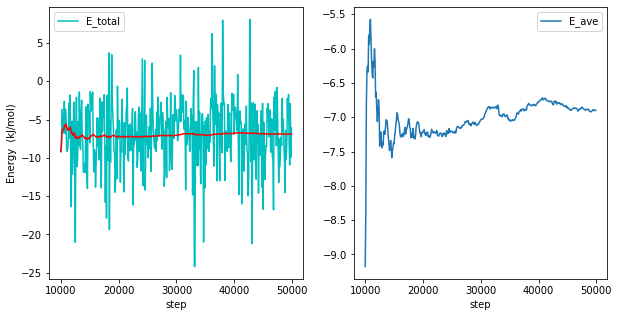

In [37]:
import matplotlib.pyplot as plt
data=pd.read_csv('std_E_tot_40.csv')
print(data)
fig,ax = plt.subplots(1,2,figsize=(10,5))
ax[0].plot(np.array(range(100,500))*100,data.iloc[:,0][100:-1],'c',label='E_total')

ax[0].legend()
ax[0].set_xlabel('step')
ax[0].set_ylabel('Energy  (kJ/mol)')
ave0=[data.iloc[:,0][100:i].sum()/(i-100) for i in range(101,501)]
ax[0].plot(np.array(range(100,500))*100,ave0,'r',label='E_ave')
ax[1].plot(np.array(range(100,500))*100,ave0,label='E_ave')
ax[1].legend()
ax[1].set_xlabel('step')
fig.savefig('std_energy.png')

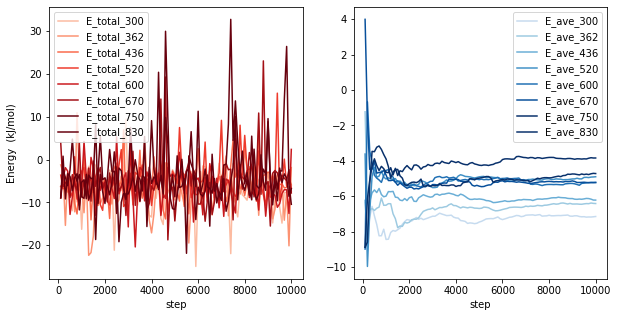

In [40]:
import matplotlib.pyplot as plt
import matplotlib
data=pd.read_csv('energy_dataframe_100.csv')
#print(data)
cmap1=matplotlib.cm.get_cmap('Reds')
fig,ax = plt.subplots(1,2,figsize=(10,5))
temp=[300,362,436,520,600,670,750,830]
for i in range(8):
    ax[0].plot(range(100,10100,100),data.iloc[:,i][100:-1:100],color=cmap1((i+2)/8),label='E_total_{}'.format(temp[i]))

ax[0].legend()
ax[0].set_xlabel('step')
ax[0].set_ylabel('Energy  (kJ/mol)')

ave=[[data.iloc[:,d][100:i].sum()/(i-100) for i in range(101,10100,100)] for d in range(8)]
#ax[0].plot(range(0,100),ave,'r',label='E_ave')
cmap2=matplotlib.cm.get_cmap('Blues')
for i in range(8):
    ax[1].plot(range(101,10100,100),ave[i],color=cmap2((i+2)/8),label='E_ave_{}'.format(temp[i]))
ax[1].legend()
ax[1].set_xlabel('step')
fig.savefig('remd_100_energy.png')

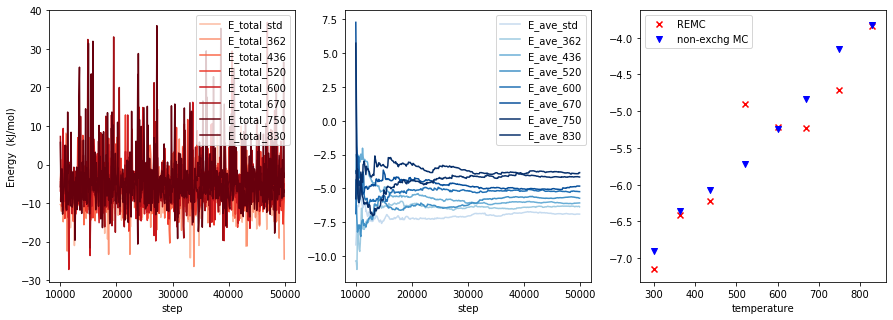

In [49]:
import matplotlib.pyplot as plt
temp1=['std',362,436,520,600,670,750,830]
data=[pd.read_csv('{}_E_tot_40.csv'.format(temp1[i])) for i in range(8)]
#print(data)
fig,ax = plt.subplots(1,3,figsize=(15,5))
cmap1=matplotlib.cm.get_cmap('Reds')
for i in range(8):
    ax[0].plot(np.array(range(100,500))*100,data[i].iloc[:,0][100:-1],color=cmap1((i+2)/8),label='E_total_{}'.format(temp1[i]))

ax[0].legend()
ax[0].set_xlabel('step')
ax[0].set_ylabel('Energy  (kJ/mol)')
ave1=[[data[d].iloc[:,0][100:i].sum()/(i-100) for i in range(101,501)] for d in range(8)]
cmap2=matplotlib.cm.get_cmap('Blues')
for i in range(8):
    #ax[0].plot(np.array(range(100,500))*100,ave0,'r',label='E_ave')
    ax[1].plot(np.array(range(100,500))*100,ave1[i],color=cmap2((i+2)/8),label='E_ave_{}'.format(temp1[i]))
ax[1].legend()
ax[1].set_xlabel('step')
ax[2].scatter(temp,[ave[i][-1] for i in range(8)],marker='x',color='r',label='REMC')
ax[2].scatter(temp,[ave1[i][-1] for i in range(8)],marker='v',color='b',label='non-exchg MC')
ax[2].legend()
ax[2].set_xlabel('temperature')
fig.savefig('non_exchg_energy.png')

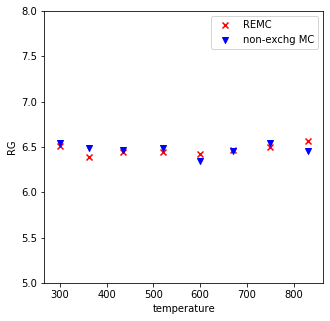

In [54]:
import matplotlib.pyplot as plt
data_ex=pd.read_csv('remd_rg_100.csv')
#print(data)
cmap1=matplotlib.cm.get_cmap('Reds')
fig,ax = plt.subplots(figsize=(5,5))
temp=[300,362,436,520,600,670,750,830]


ave_ex=[[data_ex.iloc[:,d][100:i].sum()/(i-100) for i in range(101,10100,100)] for d in range(8)]

temp1=['std',362,436,520,600,670,750,830]
data_no=[pd.read_csv('{}_rg_40.csv'.format(temp1[i])) for i in range(8)]
#print(data)


ave_no=[[data_no[d].iloc[:,0][100:i].sum()/(i-100) for i in range(101,501)] for d in range(8)]

ax.scatter(temp,[ave_ex[i][-1] for i in range(8)],marker='x',color='r',label='REMC')
ax.scatter(temp,[ave_no[i][-1] for i in range(8)],marker='v',color='b',label='non-exchg MC')
ax.set_ylim(5,8)
ax.set_ylabel('RG')
ax.legend()
ax.set_xlabel('temperature')
fig.savefig('rg_compare.png')

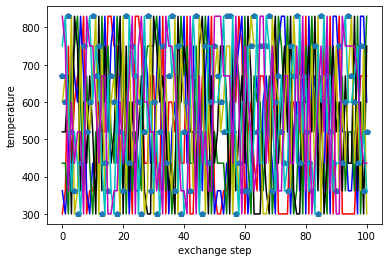

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd  
temp0=[] 
data=pd.read_csv('temp_ex_dataframe.csv_100',delimiter=',')
for column in data.walker0:
    temp0.append(column)
fig, ax = plt.subplots()
ax.plot(range(101),data.walker0,'r',data.walker1,'b',data.walker2,'g', \
    data.walker3,'k',data.walker4,'y',data.walker5,'p',data.walker6,'c',data.walker7,'m')
ax.set_xlabel('exchange step')
ax.set_ylabel('temperature')
plt.savefig('plot_temp_ex_dataframe_100.png')